In [1]:
using LightGraphs
include("EpiSim.jl")
using Plots
using GraphPlot, Compose

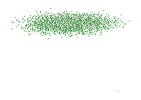

In [2]:
net=barabasi_albert(1000,3,2)
gplot(net,nodefillc=colorant"green")

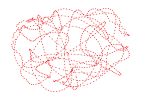

In [3]:
net=watts_strogatz(1000,4,0.001)
gplot(net,nodefillc=colorant"red")

In [4]:
net=dorogovtsev_mendes(1000)

{1000, 1997} undirected simple Int64 graph

In [5]:
function getbiggestbit(net)
    cc=connected_components(net)
    bigi=0
    bign=0
    for i in 1:length(cc)
        if length(cc[i])>bign 
            bign=length(cc[i])
            bigi=i
        end
    end
    return cc[bigi]
end

getbiggestbit (generic function with 1 method)

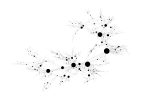

In [6]:
net=net[getbiggestbit(net)]
ndsz=[length(neighbors(net,vert)) for vert in vertices(net)]
gplot(net, nodefillc=colorant"black",nodesize=ndsz,NODESIZE=0.05)

In [7]:
function rewire!(net,p)
    #rewire edges of a graph with probability p
    vert=vertices(net)
    for edg in edges(net) #just do it the slow and literal way - we've got time
        #assuming that the iterator is created at the start of the loop, and the new edges don't get added on.....
        if rand(1)[1]<p
            #rewire
            rem_edge!(net,edg)
            add_edge!(net,edg.src,rand(vert[vert.!=edg.src]))
        end
    end
    return net
end


rewire! (generic function with 1 method)

In [22]:
net=LightGraphs.grid([100, 100], periodic=true)
println("radius=",radius(net))
gplot(net)

radius=100


In [25]:
rewire!(net,0.1)
println("radius=",radius(net))
gplot(net)

radius=12


In [24]:
radius(net) 

24

# Testing Only

### Michael Small 6/6/20